In [9]:
import numpy as np
import matplotlib.pyplot as plt
import re
from textwrap import wrap
color_list = [
    "cornflowerblue",
    "orange",
    "deeppink",
    "blueviolet",
    "seagreen",
    "black",
]
linestyle_list=["-","--","-.",":"]
from util.consts import get_base_delay_path,get_base_delay_transmission
def plot_cdf(
    raw_data,
    file_name,
    linelabels,
    x_label,
    y_label="CDF",
    log_switch=False,
    rotate_xaxis=False,
    ylim_low=0,
    xlim=None,
    xlim_bottom=None,
    fontsize=15,
    legend_font=15,
    loc=2,
    title=None,
    enable_abs=False,
    group_size=1,
):
    _fontsize = fontsize
    fig = plt.figure(figsize=(6, 4))  # 2.5 inch for 1/3 double column width
    ax = fig.add_subplot(111)
    ax.spines["right"].set_visible(False)
    ax.spines["top"].set_visible(False)

    ax.tick_params(axis="y", direction="in")
    ax.tick_params(axis="x", direction="in")
    if log_switch:
        ax.set_xscale("log")

    plt.ylabel(y_label, fontsize=_fontsize)
    plt.xlabel(x_label, fontsize=_fontsize)
    linelabels = ["\n".join(wrap(l, 30)) for l in linelabels]
    for i in range(len(raw_data)):
        data = raw_data[i]
        data = data[~np.isnan(data)]
        if len(data) == 0:
            continue
        if enable_abs:
            data = abs(data)
        # data=random.sample(data,min(1e6,len(data)))
        data_size = len(data)
        # data=list(filter(lambda score: 0<=score < std_val, data))
        # Set bins edges
        data_set = sorted(set(data))
        bins = np.append(data_set, data_set[-1] + 1)

        # Use the histogram function to bin the data
        counts, bin_edges = np.histogram(data, bins=bins, density=False)

        counts = counts.astype(float) / data_size

        # Find the cdf
        cdf = np.cumsum(counts)

        # Plot the cdf
        if i < len(linelabels):
            plt.plot(
                bin_edges[0:-1],
                cdf,
                linestyle=linestyle_list[(i // group_size) % len(linestyle_list)],
                color=color_list[(i % group_size) % len(color_list)],
                label=linelabels[i],
                linewidth=3,
            )
        else:
            plt.plot(
                bin_edges[0:-1],
                cdf,
                linestyle=linestyle_list[(i // group_size) % len(linestyle_list)],
                color=color_list[(i % group_size) % len(color_list)],
                linewidth=3,
            )

    legend_properties = {"size": legend_font}
    plt.legend(
        prop=legend_properties,
        frameon=False,
        loc=loc,
    )

    plt.ylim((ylim_low, 1))
    if xlim_bottom:
        plt.xlim(left=xlim_bottom)
    if xlim:
        plt.xlim(right=xlim)
    # plt.tight_layout()
    # plt.tight_layout(pad=0.5, w_pad=0.04, h_pad=0.01)
    plt.yticks(fontsize=_fontsize)
    plt.xticks(fontsize=_fontsize)
    # plt.grid(True)
    if rotate_xaxis:
        plt.setp(ax.get_xticklabels(), rotation=30, horizontalalignment="right")
    if title:
        plt.title(title, fontsize=_fontsize - 5)
    # plt.savefig(file_name, bbox_inches="tight", pad_inches=0)

lr =10
UNIT_G=1e9
MTU=1000
labels = {
    0: "(0,1KB]",
    1: "(1KB,10KB]",
    2: "(10KB,50KB]",
    3: "(50KB,inf)",
}

[('2/ns3', (0, 31), '_topology_flows_dctcp')]
sizes=40000, fats=40000, fcts=40000, i_fcts=40000, sldns=40000
************************************************************************************************************************************************
2/ns3
p99 percentile: 14.865566314553993
p99 percentile: 8.739421883743871
p99 percentile: 11.023463993347521
p99 percentile: 11.918674484887555
p99 percentile: 35478.920000000006
p99 percentile: 85557.90000000002
p99 percentile: 392693.62999999995
p99 percentile: 3533059.4500000007
p99 percentile: 8404.84
p99 percentile: 15804.880000000001
p99 percentile: 47211.35
p99 percentile: 609828.6200000008


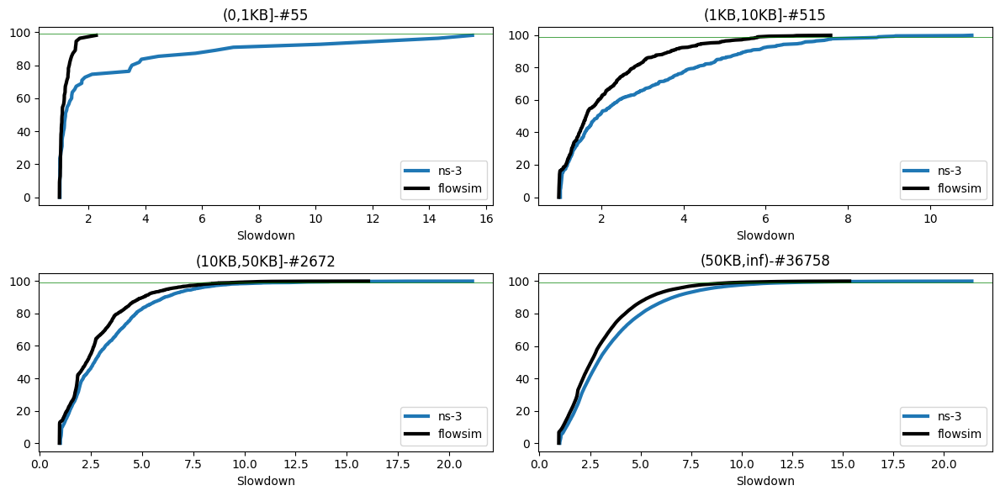

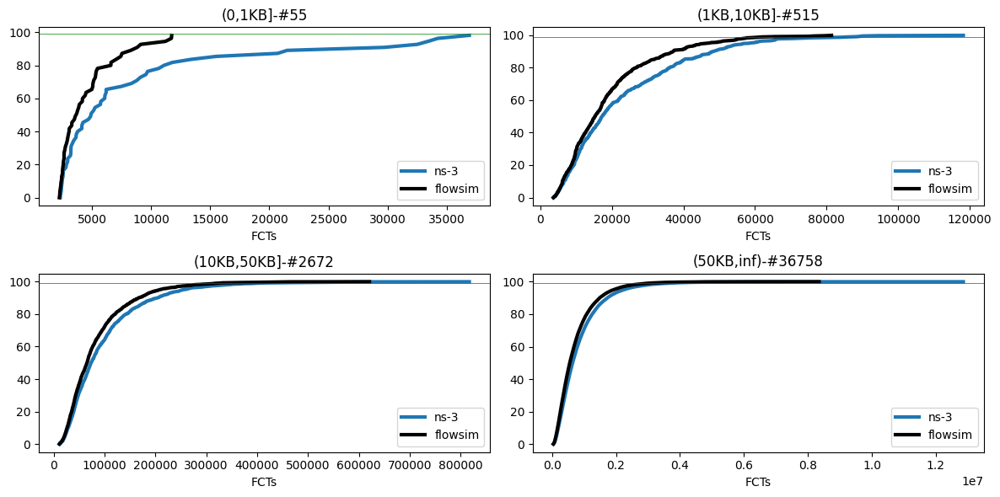

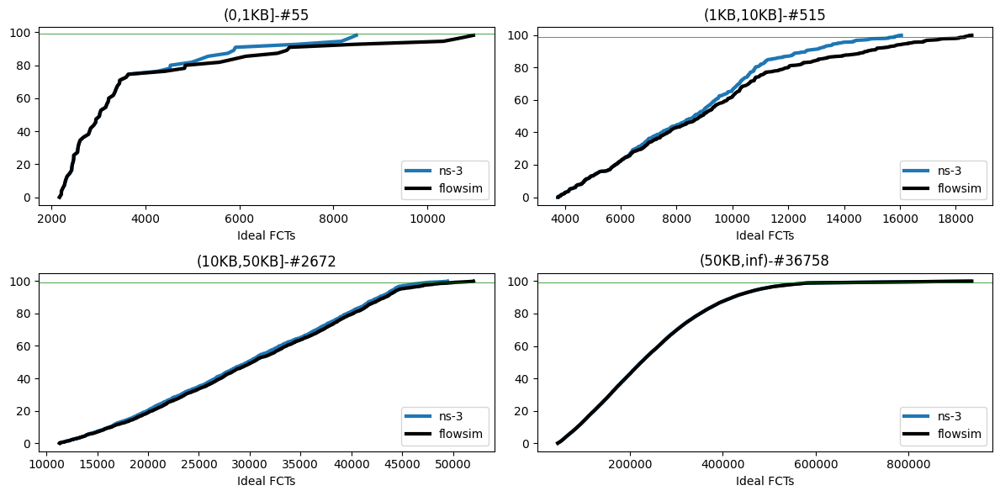

In [19]:

dir_input_synthetic="/data1/lichenni/projects/per-flow-sim/parsimon-eval/expts/fig_8/data"
dir_input_str=""


topo_type="_topology_flows_dctcp"
data_list_seeds = []
enable_longest_foreground_traffic=True
dir_input=dir_input_synthetic

data_list=[]
# for shard in np.arange(1):
for shard in [2]:
    for n_flows in [40000]:
        for n_hosts in [32]:
            for sample in [0]:
                topo_type_cur=topo_type
                spec=f"{shard}/ns3"
                fid = np.load(f"{dir_input}/{spec}/fid{topo_type_cur}.npy")
                if len(fid)==len(set(fid)) and np.all(fid[:-1] <= fid[1:]) and len(fid)%n_flows==0:
                    data_list.append((spec,(0,n_hosts-1),topo_type_cur))
               
print(data_list)
BDP=10*MTU
# [FINAL]: NS3 vs MaxMinFair
fig_index=0
plt.figure(fig_index,figsize=(12, 6))
for spec_idx,(spec,src_dst_pair_target,topo_type) in enumerate(data_list):
    dir_input_tmp = f"{dir_input}/{spec}"
    
    sizes = np.load(f"{dir_input_tmp}/fsize.npy")
    fats = np.load(f"{dir_input_tmp}/fat.npy")
    fcts = np.load(f'{dir_input_tmp}/fct{topo_type}.npy')
    i_fcts = np.load(f'{dir_input_tmp}/fct_i{topo_type}.npy')
    sldns = np.divide(fcts, i_fcts)
    
    link_info = np.load(
        f"{dir_input_tmp}/flow_to_path.npy",
        allow_pickle=True,
    )
    n_links_passed = np.array([len(link_info[i]) for i in fid])
    base_delay=get_base_delay_path(sizes,n_links_passed,lr)
    i_fcts_flowsim = get_base_delay_transmission(sizes,lr) + base_delay
    fcts_flowsim=np.load(f'{dir_input_tmp}/flowsim_fct.npy')+base_delay
    sldns_flowsim = np.divide(fcts_flowsim, i_fcts_flowsim)
    
    print(f"sizes={len(sizes)}, fats={len(fats)}, fcts={len(fcts)}, i_fcts={len(i_fcts)}, sldns={len(sldns)}")
    
    bin = np.digitize(sizes, [MTU, BDP, 5 * BDP])

    print("************************************************************************************************************************************************")
    print(f'{spec}')
    plt.figure(fig_index,figsize=(12, 6))
    for i in range(len(labels)):
        gt = np.extract(bin==i, sldns)
        # if spec_idx==0:
        gt_flowsim = np.extract(bin==i, sldns_flowsim)
        sample_list_flowsim=np.arange(len(gt_flowsim))
            
        print(f"p99 percentile: {np.percentile(gt,99)}")
        # sample_list=sorted(np.random.choice(np.arange(len(gt)),np.min([len(gt),100000]),replace=False))
        sample_list=np.arange(len(gt))
        
        plt.subplot(2, 2, i + 1)
        plt.title(f"{labels[i]}-#{len(gt)}")
        if(len(gt)==0): continue
        # plt.xlim([0, 16])
        plt.plot(np.sort(gt)[sample_list], (np.arange(len(gt))/len(gt)*100)[sample_list], linewidth=3, label="ns-3")

        # if spec_idx==0:
        plt.plot(np.sort(gt_flowsim)[sample_list_flowsim], (np.arange(len(gt_flowsim))/len(gt_flowsim)*100)[sample_list_flowsim], label="flowsim", linewidth=3,color='black')
            
        plt.axhline(99, color='green', linewidth=0.5)
        # plt.xscale('log')
        plt.xlabel('Slowdown')
        plt.legend()
        # plt.ylim([80, 100])
    plt.tight_layout()
    fig_index+=1
    
    plt.figure(fig_index,figsize=(12, 6))
    for i in range(len(labels)):
        gt = np.extract(bin==i, fcts)
        # if spec_idx==0:
        gt_flowsim = np.extract(bin==i, fcts_flowsim)
        sample_list_flowsim=np.arange(len(gt_flowsim))
            
        print(f"p99 percentile: {np.percentile(gt,99)}")
        # sample_list=sorted(np.random.choice(np.arange(len(gt)),np.min([len(gt),100000]),replace=False))
        sample_list=np.arange(len(gt))
        
        plt.subplot(2, 2, i + 1)
        plt.title(f"{labels[i]}-#{len(gt)}")
        if(len(gt)==0): continue
        # plt.xlim([0, 16])
        plt.plot(np.sort(gt)[sample_list], (np.arange(len(gt))/len(gt)*100)[sample_list], linewidth=3, label="ns-3")

        # if spec_idx==0:
        plt.plot(np.sort(gt_flowsim)[sample_list_flowsim], (np.arange(len(gt_flowsim))/len(gt_flowsim)*100)[sample_list_flowsim], label="flowsim", linewidth=3,color='black')
            
        plt.axhline(99, color='green', linewidth=0.5)
        # plt.xscale('log')
        plt.xlabel('FCTs')
        plt.legend()
        # plt.ylim([80, 100])
    plt.tight_layout()
    fig_index+=1
    
    plt.figure(fig_index,figsize=(12, 6))
    for i in range(len(labels)):
        gt = np.extract(bin==i, i_fcts)
        # if spec_idx==0:
        gt_flowsim = np.extract(bin==i, i_fcts_flowsim)
        sample_list_flowsim=np.arange(len(gt_flowsim))
            
        print(f"p99 percentile: {np.percentile(gt,99)}")
        # sample_list=sorted(np.random.choice(np.arange(len(gt)),np.min([len(gt),100000]),replace=False))
        sample_list=np.arange(len(gt))
        
        plt.subplot(2, 2, i + 1)
        plt.title(f"{labels[i]}-#{len(gt)}")
        if(len(gt)==0): continue
        # plt.xlim([0, 16])
        plt.plot(np.sort(gt)[sample_list], (np.arange(len(gt))/len(gt)*100)[sample_list], linewidth=3, label="ns-3")

        # if spec_idx==0:
        plt.plot(np.sort(gt_flowsim)[sample_list_flowsim], (np.arange(len(gt_flowsim))/len(gt_flowsim)*100)[sample_list_flowsim], label="flowsim", linewidth=3,color='black')
            
        plt.axhline(99, color='green', linewidth=0.5)
        # plt.xscale('log')
        plt.xlabel('Ideal FCTs')
        plt.legend()
        # plt.ylim([80, 100])
    plt.tight_layout()
    fig_index+=1

In [17]:
import json
data_path="/data2/lichenni/output_perflow/topo_512_flowsim_input_remainsize_link_shard1000_nflows1_nhosts1_nsamples1_lr10Gbps/version_0/data_list.json"
# data_path="/data2/lichenni/output_perflow/debug_shard1000_nflows1_nhosts1_nsamples1_lr10Gbps/version_0/data_list.json"
dir_input="/data1/lichenni/projects/per-flow-sim/parsimon-eval/expts/fig_8/data"
flow_size_threshold=100000000
data_list=json.load(open(data_path))
data_list=data_list["train"]

print(len(data_list))
BDP=10*MTU
# [FINAL]: NS3 vs MaxMinFair
res_ns3_total=[]
res_flowsim_total=[]

res_ns3=[[] for _ in range(4)]
res_flowsim=[[] for _ in range(4)]

for spec_idx,(spec, src_dst_pair_target, topo_type, segment_id, _) in enumerate(data_list):
    dir_input_tmp = f"{dir_input}/{spec}"
    busy_periods=np.load(
        f"{dir_input_tmp}/period{topo_type}_t{flow_size_threshold}.npy",
        allow_pickle=True,
    )
    fid=np.array(busy_periods[segment_id])
    
    sizes = np.load(f"{dir_input_tmp}/fsize.npy")[fid]
    fats = np.load(f"{dir_input_tmp}/fat.npy")[fid]
    fcts = np.load(f'{dir_input_tmp}/fct{topo_type}.npy')[fid]
    i_fcts = np.load(f'{dir_input_tmp}/fct_i{topo_type}.npy')[fid]
    sldns = np.divide(fcts, i_fcts)
    
    link_info = np.load(
        f"{dir_input_tmp}/flow_to_path.npy",
        allow_pickle=True,
    )
    n_links_passed = np.array([len(link_info[i]) for i in fid])
    base_delay=get_base_delay_path(sizes,n_links_passed,lr)
    i_fcts_flowsim = get_base_delay_transmission(sizes,lr) + base_delay
    fcts_flowsim=np.load(f'{dir_input_tmp}/flowsim_fct.npy')[fid]+base_delay
    sldns_flowsim = np.divide(fcts_flowsim, i_fcts_flowsim)
    
    bins_size=np.digitize(sizes, [MTU, BDP, 5 * BDP])
    
    for i in range(4):
        gt = np.extract(bins_size==i, sldns)
        gt_flowsim = np.extract(bins_size==i, sldns_flowsim)
        res_ns3[i].extend(gt)
        res_flowsim[i].extend(gt_flowsim)
    
    res_ns3_total.extend(sldns)
    res_flowsim_total.extend(sldns_flowsim)
res_ns3_total=np.array(res_ns3_total)
res_flowsim_total=np.array(res_flowsim_total)
print(res_ns3_total.shape)
print(res_flowsim_total.shape)

896
(71074,)
(71074,)


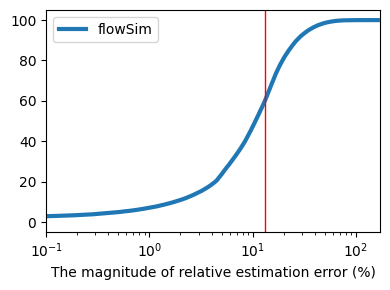

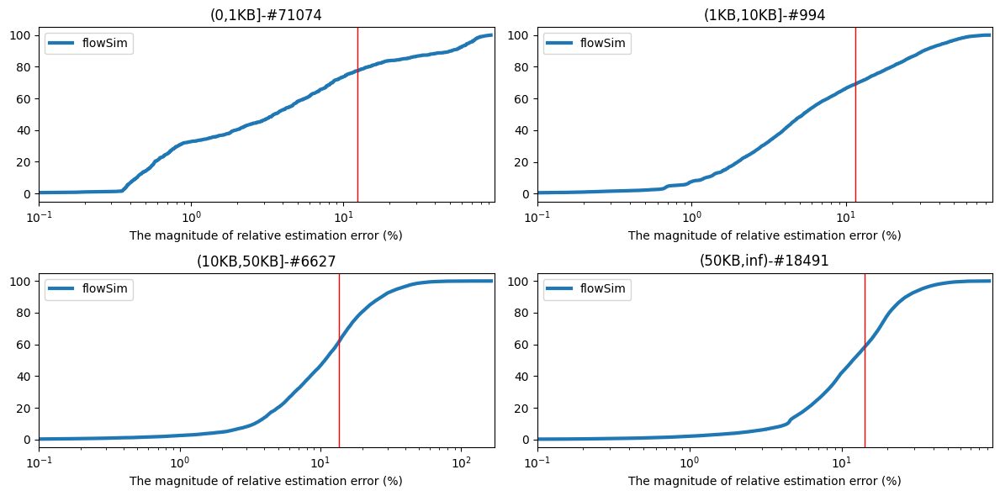

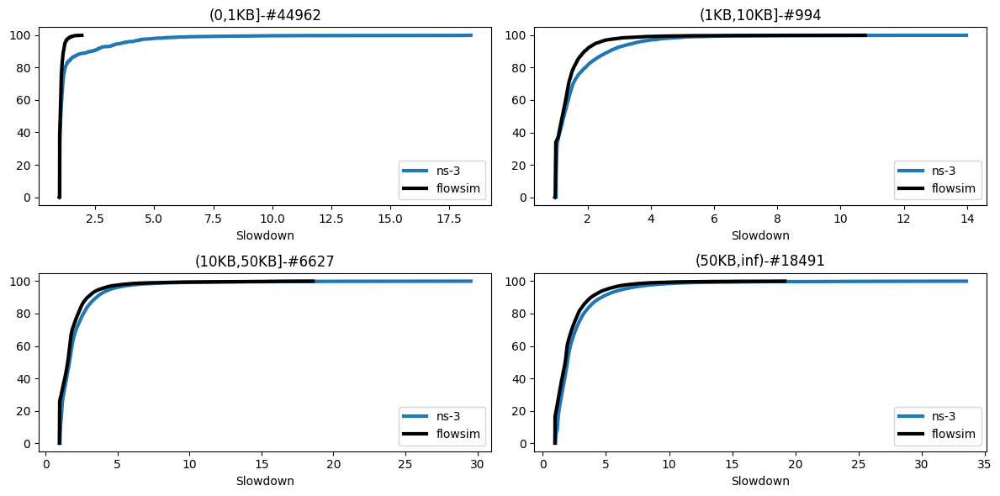

In [18]:
res_ns3_total[res_ns3_total<1]=1
res_flowsim_total[res_flowsim_total<1]=1
gt=abs(res_ns3_total-res_flowsim_total)/res_ns3_total*100
# gt_flowsim=res_flowsim

fig_index=0
plt.figure(fig_index,figsize=(4, 3))  
plt.plot(np.sort(gt), (np.arange(len(gt))/len(gt)*100), linewidth=3, label="flowSim")
# plt.axhline(99, color='green', linewidth=0.5)
# plt.axvline(np.percentile(gt,50), color='red', linewidth=1)
plt.axvline(np.mean(gt), color='red', linewidth=1)
# plt.xscale('log')
plt.xlabel('The magnitude of relative estimation error (%)')
plt.legend()
# plt.ylim([80, 100])
plt.xlim(left=0.1)
plt.xscale('log')
plt.tight_layout()
fig_index+=1

plt.figure(fig_index,figsize=(12, 6))  
for i in range(len(labels)):
    plt.subplot(2, 2, i + 1)
    plt.title(f"{labels[i]}-#{len(gt)}")
    # plt.xlim([0, 16])
    gt=np.array(res_ns3[i])
    gt_flowsim=np.array(res_flowsim[i])
    
    res=abs(gt-gt_flowsim)/gt*100
    plt.plot(np.sort(res), (np.arange(len(res))/len(res)*100), linewidth=3, label="flowSim")
    # plt.plot(np.sort(gt), (np.arange(len(gt))/len(gt)*100), linewidth=3, label="ns-3")
    # plt.plot(np.sort(gt_flowsim), (np.arange(len(gt_flowsim))/len(gt_flowsim)*100), label="flowsim", linewidth=3,color='black')
        
    # plt.axvline(np.percentile(res,50), color='red', linewidth=1)
    plt.axvline(np.mean(res), color='red', linewidth=1)
    plt.xlim(left=0.1)
    plt.xscale('log')
    plt.xlabel('The magnitude of relative estimation error (%)')
    plt.legend()
    # plt.ylim([80, 100])
plt.tight_layout()
fig_index+=1

plt.figure(fig_index,figsize=(12, 6))  
for i in range(len(labels)):
    plt.subplot(2, 2, i + 1)
    plt.title(f"{labels[i]}-#{len(gt)}")
    # plt.xlim([0, 16])
    gt=np.array(res_ns3[i])
    gt_flowsim=np.array(res_flowsim[i])
    
    plt.plot(np.sort(gt), (np.arange(len(gt))/len(gt)*100), linewidth=3, label="ns-3")
    plt.plot(np.sort(gt_flowsim), (np.arange(len(gt_flowsim))/len(gt_flowsim)*100), label="flowsim", linewidth=3,color='black')
        
    # plt.xscale('log')
    plt.xlabel('Slowdown')
    plt.legend()
    # plt.ylim([80, 100])
plt.tight_layout()
fig_index+=1

In [8]:

dir_input_synthetic="/data1/lichenni/projects/per-flow-sim/parsimon-eval/expts/fig_8/data"
dir_input_str=""


topo_type="_topology_flows_dctcp"
data_list_seeds = []
enable_longest_foreground_traffic=True
dir_input=dir_input_synthetic

data_list=[]
for shard in np.arange(1000):
# for shard in [2]:
    for n_flows in [20000]:
        for n_hosts in [20]:
            for sample in [0]:
                topo_type_cur=topo_type
                spec=f"{shard}/ns3"
                fid = np.load(f"{dir_input}/{spec}/fid{topo_type_cur}.npy")
                if len(fid)==len(set(fid)) and np.all(fid[:-1] <= fid[1:]) and len(fid)%n_flows==0:
                    data_list.append((spec,(0,n_hosts-1),topo_type_cur))
               
print(len(data_list))
BDP=10*MTU
# [FINAL]: NS3 vs MaxMinFair

res_ns3=[]
res_flowsim=[]


for spec_idx,(spec,src_dst_pair_target,topo_type) in enumerate(data_list):
    dir_input_tmp = f"{dir_input}/{spec}"
    
    sizes = np.load(f"{dir_input_tmp}/fsize.npy")
    fats = np.load(f"{dir_input_tmp}/fat.npy")
    fcts = np.load(f'{dir_input_tmp}/fct{topo_type}.npy')
    i_fcts = np.load(f'{dir_input_tmp}/fct_i{topo_type}.npy')
    sldns = np.divide(fcts, i_fcts)
    
    link_info = np.load(
        f"{dir_input_tmp}/flow_to_path.npy",
        allow_pickle=True,
    )
    n_links_passed = np.array([len(link_info[i]) for i in range(len(fcts))])
    base_delay=get_base_delay_path(sizes,n_links_passed,lr)
    i_fcts_flowsim = get_base_delay_transmission(sizes,lr) + base_delay
    fcts_flowsim=np.load(f'{dir_input_tmp}/flowsim_fct.npy')+base_delay
    sldns_flowsim = np.divide(fcts_flowsim, i_fcts_flowsim)
    
    busy_periods = np.load(
        f"{dir_input_tmp}/period{topo_type}_t100000000.npy",
        allow_pickle=True,
    )
    res_ns3_tmp=[]
    res_flowsim_tmp=[]
    if len(busy_periods)>500:
        busy_periods=np.random.choice(busy_periods,500,replace=False)
    for segment_id in range(len(busy_periods)):
        fid = np.array(busy_periods[segment_id]).astype(int)
        # if len(fid)>4000:
        #     continue
        size_tmp=sizes[fid]
        sldns_tmp=sldns[fid]
        sldns_flowsim_tmp=sldns_flowsim[fid]
        
        bin=np.digitize(size_tmp, [MTU, BDP, 5 * BDP])
        tmp_res_ns3=[]
        tmp_res_flowsim=[]
        for i in range(len(labels)):
            gt = np.extract(bin==i, sldns_tmp)
            gt_flowsim = np.extract(bin==i, sldns_flowsim_tmp)
            if len(gt)==0:
                tmp_res_ns3.append(0)
                tmp_res_flowsim.append(0)
                continue
            # tmp_res_ns3.append(np.max(gt))
            # tmp_res_flowsim.append(np.max(gt_flowsim))
            tmp_res_ns3.extend(gt)
            tmp_res_flowsim.extend(gt_flowsim)
        # res_ns3_tmp.append(tmp_res_ns3)
        # res_flowsim_tmp.append(tmp_res_flowsim)
        res_ns3_tmp.extend(tmp_res_ns3)
        res_flowsim_tmp.extend(tmp_res_flowsim)
    
    # res_ns3.append(np.max(res_ns3_tmp,axis=0))
    # res_flowsim.append(np.max(res_flowsim_tmp,axis=0))
    res_ns3.extend(res_ns3_tmp)
    res_flowsim.extend(res_flowsim_tmp)
res_ns3=np.array(res_ns3)
res_flowsim=np.array(res_flowsim)
print(res_ns3.shape)
print(res_flowsim.shape)

999
fid=[8935]
fid=[13623]
fid=[4187]
fid=[4801 4802]
fid=[9737]
fid=[4438]
fid=[156]
fid=[2844]
fid=[435]
fid=[485]
fid=[10352 10366 10383 10391]
fid=[7488]
fid=[4402]
fid=[2146]
fid=[17260]
fid=[468]
fid=[15164]
fid=[3079]
fid=[18331]
fid=[10092 10095]
fid=[7908]
fid=[19364]
fid=[13806]
fid=[9300]
fid=[5025]
fid=[1798 1818 1838]
fid=[4607]
fid=[18478]
fid=[12738]
fid=[4712]
fid=[18552 18556]
fid=[2150]
fid=[2155]
fid=[297]
fid=[3069]
fid=[14622 14633 14643 14649]
fid=[4620]
fid=[3834]
fid=[2570]
fid=[6908]
fid=[5808]
fid=[993]
fid=[9327]
fid=[300]
fid=[9017]
fid=[6180]
fid=[1575 1577 1579]
fid=[10828]
fid=[2133]
fid=[1619]
fid=[11211]
fid=[451 453 454 466]
fid=[17486 17492]
fid=[11581]
fid=[15173]
fid=[4874 4881]
fid=[9669]
fid=[13699]
fid=[6897]
fid=[7205]
fid=[9583 9585]
fid=[12766]
fid=[9746]
fid=[19514]
fid=[9909]
fid=[2568]
fid=[10605]
fid=[9663 9673]
fid=[7500]
fid=[4363 4368]
fid=[18052]
fid=[4768 4769 4773]
fid=[1452]
fid=[19257]
fid=[1121]
fid=[3916]
fid=[4817 4818 4827]
fid

/data1/lichenni/software/anaconda3/envs/py39/lib/python3.9/site-packages/IPython/core/events.py:89: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


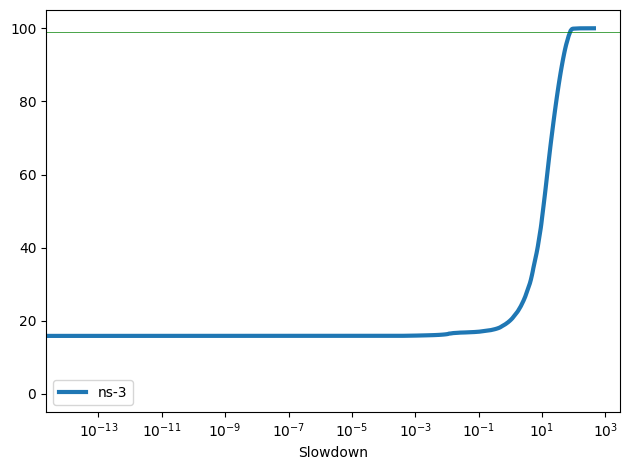

In [9]:
res_ns3[res_ns3<1]=1
res_flowsim[res_flowsim<1]=1
gt=abs(res_ns3-res_flowsim)/res_ns3*100
# gt_flowsim=res_flowsim

fig_index=0
plt.plot(np.sort(gt), (np.arange(len(gt))/len(gt)*100), linewidth=3, label="ns-3")

# if spec_idx==0:
# plt.plot(np.sort(gt_flowsim), (np.arange(len(gt_flowsim))/len(gt_flowsim)*100), label="flowsim", linewidth=3,color='black')
    
plt.axhline(99, color='green', linewidth=0.5)
plt.xscale('log')
plt.xlabel('Slowdown')
plt.legend()
# plt.ylim([80, 100])
plt.tight_layout()
fig_index+=1

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

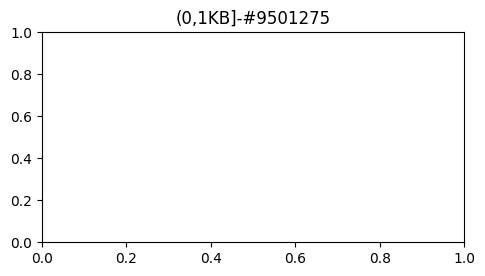

In [10]:
fig_index=0
plt.figure(fig_index,figsize=(12, 6))  
for i in range(len(labels)):
    plt.subplot(2, 2, i + 1)
    plt.title(f"{labels[i]}-#{len(gt)}")
    # plt.xlim([0, 16])
    gt=res_ns3[:,i]
    gt_flowsim=res_flowsim[:,i]
    
    plt.plot(np.sort(gt), (np.arange(len(gt))/len(gt)*100), linewidth=3, label="ns-3")

    # if spec_idx==0:
    plt.plot(np.sort(gt_flowsim), (np.arange(len(gt_flowsim))/len(gt_flowsim)*100), label="flowsim", linewidth=3,color='black')
        
    plt.axhline(99, color='green', linewidth=0.5)
    # plt.xscale('log')
    plt.xlabel('Slowdown')
    plt.legend()
    # plt.ylim([80, 100])
plt.tight_layout()
fig_index+=1

In [12]:

dir_input_synthetic="/data1/lichenni/projects/per-flow-sim/parsimon-eval/expts/fig_8/data"
dir_input_str=""


topo_type="_topology_flows_dctcp"
data_list_seeds = []
enable_longest_foreground_traffic=True
dir_input=dir_input_synthetic

data_list=[]
for shard in np.arange(1000):
# for shard in [2]:
    for n_flows in [20000]:
        for n_hosts in [32]:
            for sample in [0]:
                topo_type_cur=topo_type
                spec=f"{shard}/ns3"
                fid = np.load(f"{dir_input}/{spec}/fid{topo_type_cur}.npy")
                if len(fid)==len(set(fid)) and np.all(fid[:-1] <= fid[1:]) and len(fid)%n_flows==0:
                    data_list.append((spec,(0,n_hosts-1),topo_type_cur))
               
print(len(data_list))
BDP=10*MTU
# [FINAL]: NS3 vs MaxMinFair

res_ns3=[]
res_flowsim=[]


for spec_idx,(spec,src_dst_pair_target,topo_type) in enumerate(data_list):
    dir_input_tmp = f"{dir_input}/{spec}"
    
    sizes = np.load(f"{dir_input_tmp}/fsize.npy")
    fats = np.load(f"{dir_input_tmp}/fat.npy")
    fcts = np.load(f'{dir_input_tmp}/fct{topo_type}.npy')
    i_fcts = np.load(f'{dir_input_tmp}/fct_i{topo_type}.npy')
    sldns = np.divide(fcts, i_fcts)
    
    link_info = np.load(
        f"{dir_input_tmp}/flow_to_path.npy",
        allow_pickle=True,
    )
    n_links_passed = np.array([len(link_info[i]) for i in range(len(fcts))])
    base_delay=get_base_delay_path(sizes,n_links_passed,lr)
    i_fcts_flowsim = get_base_delay_transmission(sizes,lr) + base_delay
    fcts_flowsim=np.load(f'{dir_input_tmp}/flowsim_fct.npy')+base_delay
    sldns_flowsim = np.divide(fcts_flowsim, i_fcts_flowsim)
    
    bin=np.digitize(sizes, [MTU, BDP, 5 * BDP])
    tmp_res_ns3=[]
    tmp_res_flowsim=[]
    for i in range(len(labels)):
        gt = np.extract(bin==i, sldns)
        gt_flowsim = np.extract(bin==i, sldns_flowsim)
        if len(gt)==0:
            tmp_res_ns3.append(0)
            tmp_res_flowsim.append(0)
            continue
        tmp_res_ns3.append(np.max(gt))
        tmp_res_flowsim.append(np.max(gt_flowsim))
    res_ns3.append(tmp_res_ns3)
    res_flowsim.append(tmp_res_flowsim)
    
res_ns3=np.array(res_ns3)
res_flowsim=np.array(res_flowsim)
print(res_ns3.shape)
print(res_flowsim.shape)

999


(999, 4)
(999, 4)


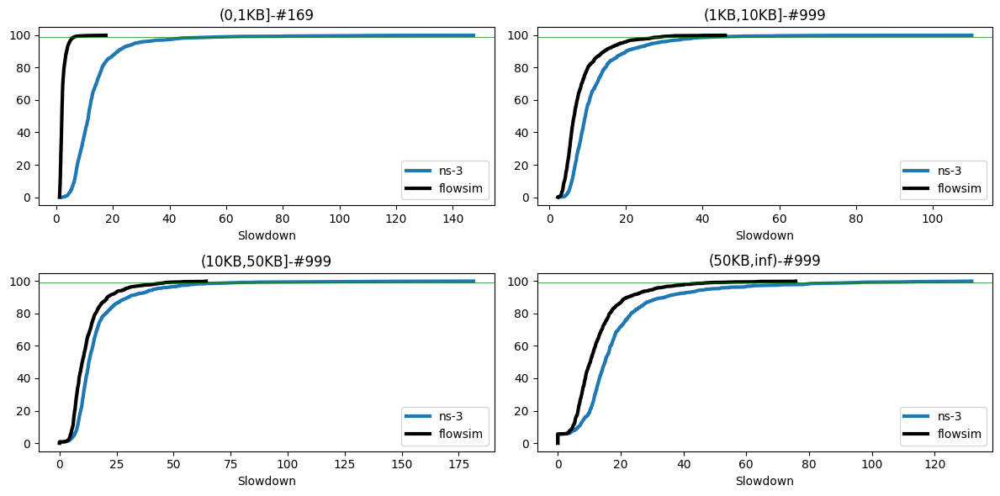

In [13]:
fig_index=0
plt.figure(fig_index,figsize=(12, 6))  
for i in range(len(labels)):
    plt.subplot(2, 2, i + 1)
    plt.title(f"{labels[i]}-#{len(gt)}")
    # plt.xlim([0, 16])
    gt=res_ns3[:,i]
    gt_flowsim=res_flowsim[:,i]
    
    plt.plot(np.sort(gt), (np.arange(len(gt))/len(gt)*100), linewidth=3, label="ns-3")

    # if spec_idx==0:
    plt.plot(np.sort(gt_flowsim), (np.arange(len(gt_flowsim))/len(gt_flowsim)*100), label="flowsim", linewidth=3,color='black')
        
    plt.axhline(99, color='green', linewidth=0.5)
    # plt.xscale('log')
    plt.xlabel('Slowdown')
    plt.legend()
    # plt.ylim([80, 100])
plt.tight_layout()
fig_index+=1

In [14]:

dir_input_synthetic="/data1/lichenni/projects/per-flow-sim/parsimon-eval/expts/fig_8/data"
dir_input_str=""


topo_type="_topology_flows_dctcp"
data_list_seeds = []
enable_longest_foreground_traffic=True
dir_input=dir_input_synthetic

data_list=[]
for shard in np.arange(1000):
# for shard in [2]:
    for n_flows in [20000]:
        for n_hosts in [32]:
            for sample in [0]:
                topo_type_cur=topo_type
                spec=f"{shard}/ns3"
                try:
                    fid = np.load(f"{dir_input}/{spec}/fid{topo_type_cur}.npy")
                    if len(fid)==len(set(fid)) and np.all(fid[:-1] <= fid[1:]):
                        data_list.append((spec,(0,n_hosts-1),topo_type_cur))
                except:
                    continue
               
print(len(data_list))
BDP=10*MTU
# [FINAL]: NS3 vs MaxMinFair

res_ns3_total=[]
res_flowsim_total=[]

res_ns3=[[] for _ in range(4)]
res_flowsim=[[] for _ in range(4)]


for spec_idx,(spec,src_dst_pair_target,topo_type) in enumerate(data_list):
    dir_input_tmp = f"{dir_input}/{spec}"
    fid=np.load(f"{dir_input_tmp}/fid{topo_type}.npy")
    sizes = np.load(f"{dir_input_tmp}/fsize.npy")
    fats = np.load(f"{dir_input_tmp}/fat.npy")
    fcts = np.load(f'{dir_input_tmp}/fct{topo_type}.npy')
    i_fcts = np.load(f'{dir_input_tmp}/fct_i{topo_type}.npy')
    sldns = np.divide(fcts, i_fcts)
    
    link_info = np.load(
        f"{dir_input_tmp}/flow_to_path.npy",
        allow_pickle=True,
    )
    n_links_passed = np.array([len(link_info[i]) for i in fid])
    base_delay=get_base_delay_path(sizes,n_links_passed,lr)
    i_fcts_flowsim = get_base_delay_transmission(sizes,lr) + base_delay
    fcts_flowsim=np.load(f'{dir_input_tmp}/flowsim_fct.npy')+base_delay
    sldns_flowsim = np.divide(fcts_flowsim, i_fcts_flowsim)
        
    bins_size=np.digitize(sizes, [MTU, BDP, 5 * BDP])
    for i in range(len(labels)):
        gt = np.extract(bins_size==i, sldns)
        gt_flowsim = np.extract(bins_size==i, sldns_flowsim)
        res_ns3[i].extend(gt)
        res_flowsim[i].extend(gt_flowsim)
    res_ns3_total.extend(sldns)
    res_flowsim_total.extend(sldns_flowsim)
   
res_ns3_total=np.array(res_ns3_total)
res_flowsim_total=np.array(res_flowsim_total)
print(res_ns3_total.shape)
print(res_flowsim_total.shape)

1000
(19999999,)
(19999999,)


/tmp/ipykernel_1331132/3324651118.py:17: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()
/tmp/ipykernel_1331132/3324651118.py:58: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()
/data1/lichenni/software/anaconda3/envs/py39/lib/python3.9/site-packages/IPython/core/pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


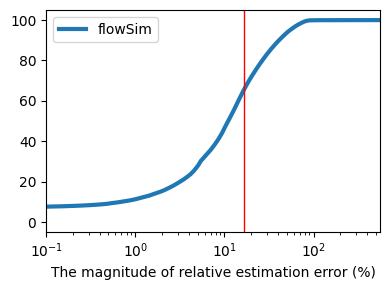

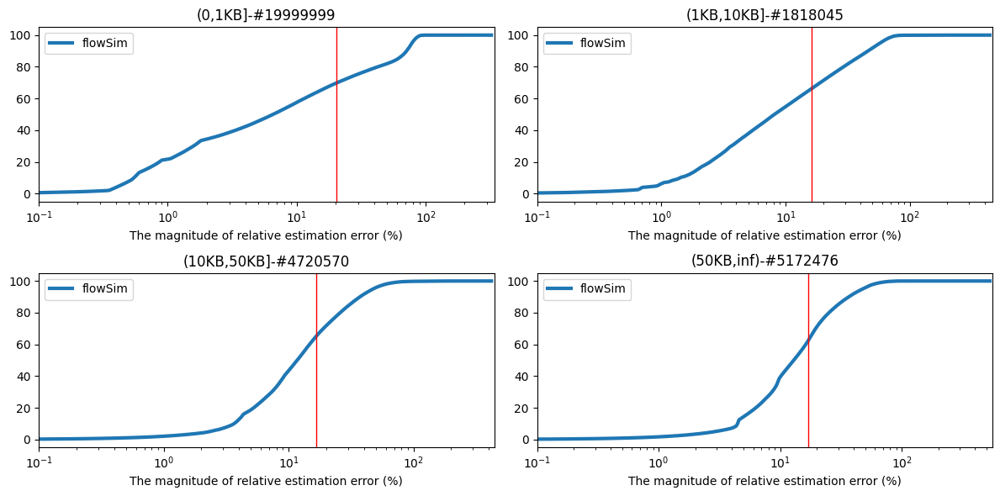

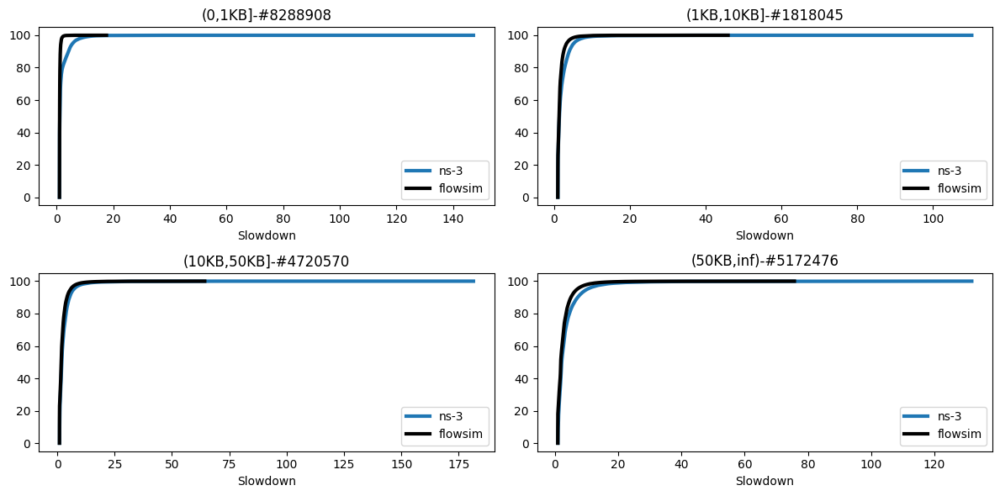

In [15]:
res_ns3_total[res_ns3_total<1]=1
res_flowsim_total[res_flowsim_total<1]=1
gt=abs(res_ns3_total-res_flowsim_total)/res_ns3_total*100
# gt_flowsim=res_flowsim

fig_index=0
plt.figure(fig_index,figsize=(4, 3))  
plt.plot(np.sort(gt), (np.arange(len(gt))/len(gt)*100), linewidth=3, label="flowSim")
# plt.axhline(99, color='green', linewidth=0.5)
# plt.axvline(np.percentile(gt,50), color='red', linewidth=1)
plt.axvline(np.mean(gt), color='red', linewidth=1)
plt.xlim(left=0.1)
plt.xscale('log')
plt.xlabel('The magnitude of relative estimation error (%)')
plt.legend()
# plt.ylim([80, 100])
plt.tight_layout()
fig_index+=1

plt.figure(fig_index,figsize=(12, 6))  
for i in range(len(labels)):
    plt.subplot(2, 2, i + 1)
    plt.title(f"{labels[i]}-#{len(gt)}")
    # plt.xlim([0, 16])
    gt=np.array(res_ns3[i])
    gt_flowsim=np.array(res_flowsim[i])
    
    res=abs(gt-gt_flowsim)/gt*100
    plt.plot(np.sort(res), (np.arange(len(res))/len(res)*100), linewidth=3, label="flowSim")
    # plt.plot(np.sort(gt), (np.arange(len(gt))/len(gt)*100), linewidth=3, label="ns-3")
    # plt.plot(np.sort(gt_flowsim), (np.arange(len(gt_flowsim))/len(gt_flowsim)*100), label="flowsim", linewidth=3,color='black')
        
    # plt.axvline(np.percentile(res,50), color='red', linewidth=1)
    plt.axvline(np.mean(res), color='red', linewidth=1)
    plt.xlim(left=0.1)
    plt.xscale('log')
    plt.xlabel('The magnitude of relative estimation error (%)')
    plt.legend()
    # plt.ylim([80, 100])
plt.tight_layout()
fig_index+=1

plt.figure(fig_index,figsize=(12, 6))  
for i in range(len(labels)):
    plt.subplot(2, 2, i + 1)
    plt.title(f"{labels[i]}-#{len(gt)}")
    # plt.xlim([0, 16])
    gt=np.array(res_ns3[i])
    gt_flowsim=np.array(res_flowsim[i])
    
    plt.plot(np.sort(gt), (np.arange(len(gt))/len(gt)*100), linewidth=3, label="ns-3")
    plt.plot(np.sort(gt_flowsim), (np.arange(len(gt_flowsim))/len(gt_flowsim)*100), label="flowsim", linewidth=3,color='black')
        
    # plt.xscale('log')
    plt.xlabel('Slowdown')
    plt.legend()
    # plt.ylim([80, 100])
plt.tight_layout()
fig_index+=1

In [12]:

# dir_input_synthetic="/data1/lichenni/projects/per-flow-sim/parsimon-eval/expts/fig_8/data_empirical"
dir_input_synthetic="/data1/lichenni/projects/per-flow-sim/parsimon-eval/expts/fig_8/eval_test"
dir_input_str=""


topo_type="_topology_flows"
data_list_seeds = []
enable_longest_foreground_traffic=True
dir_input=dir_input_synthetic

data_list=[]
for shard in np.arange(100):
    for n_flows in [2000]:
        for n_hosts in [32]:
            for sample in [0]:
                topo_type_cur=topo_type
                spec=f"{shard}/ns3"
                try:
                    fid = np.load(f"{dir_input}/{spec}/fid{topo_type_cur}.npy")
                    if len(fid)==len(set(fid)) and np.all(fid[:-1] <= fid[1:]) and len(fid)%n_flows==0:
                        data_list.append((spec,(0,n_hosts-1),topo_type_cur))
                    else:
                        print(f"{spec}: {len(fid)}")
                except:
                    continue
               
print(len(data_list))
BDP=10*MTU
# [FINAL]: NS3 vs MaxMinFair

res_ns3_total=[]
res_flowsim_total=[]

res_ns3=[[] for _ in range(4)]
res_flowsim=[[] for _ in range(4)]


for spec_idx,(spec,src_dst_pair_target,topo_type) in enumerate(data_list):
    dir_input_tmp = f"{dir_input}/{spec}"
    fid=np.load(f"{dir_input_tmp}/fid{topo_type}.npy")
    sizes = np.load(f"{dir_input_tmp}/fsize.npy")
    fats = np.load(f"{dir_input_tmp}/fat.npy")
    fcts = np.load(f'{dir_input_tmp}/fct{topo_type}.npy')
    i_fcts = np.load(f'{dir_input_tmp}/fct_i{topo_type}.npy')
    sldns = np.divide(fcts, i_fcts)
    
    link_info = np.load(
        f"{dir_input_tmp}/flow_to_path.npy",
        allow_pickle=True,
    )
    n_links_passed = np.array([len(link_info[i]) for i in fid])
    base_delay=get_base_delay_path(sizes,n_links_passed,lr)
    i_fcts_flowsim = get_base_delay_transmission(sizes,lr) + base_delay
    fcts_flowsim=np.load(f'{dir_input_tmp}/flowsim_fct.npy')+base_delay
    sldns_flowsim = np.divide(fcts_flowsim, i_fcts_flowsim)
        
    bins_size=np.digitize(sizes, [MTU, BDP, 5 * BDP])
    for i in range(len(labels)):
        gt = np.extract(bins_size==i, sldns)
        gt_flowsim = np.extract(bins_size==i, sldns_flowsim)
        res_ns3[i].extend(gt)
        res_flowsim[i].extend(gt_flowsim)
    res_ns3_total.extend(sldns)
    res_flowsim_total.extend(sldns_flowsim)
   
res_ns3_total=np.array(res_ns3_total)
res_flowsim_total=np.array(res_flowsim_total)
print(res_ns3_total.shape)
print(res_flowsim_total.shape)

1/ns3: 1999
6/ns3: 1999
9/ns3: 1999
29/ns3: 1999
50/ns3: 1999
52/ns3: 1999
54/ns3: 1999
74/ns3: 1999
79/ns3: 1999
85/ns3: 1999
99/ns3: 1999
89
(178000,)
(178000,)


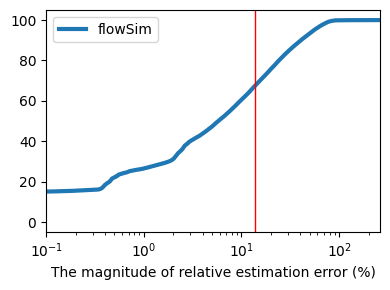

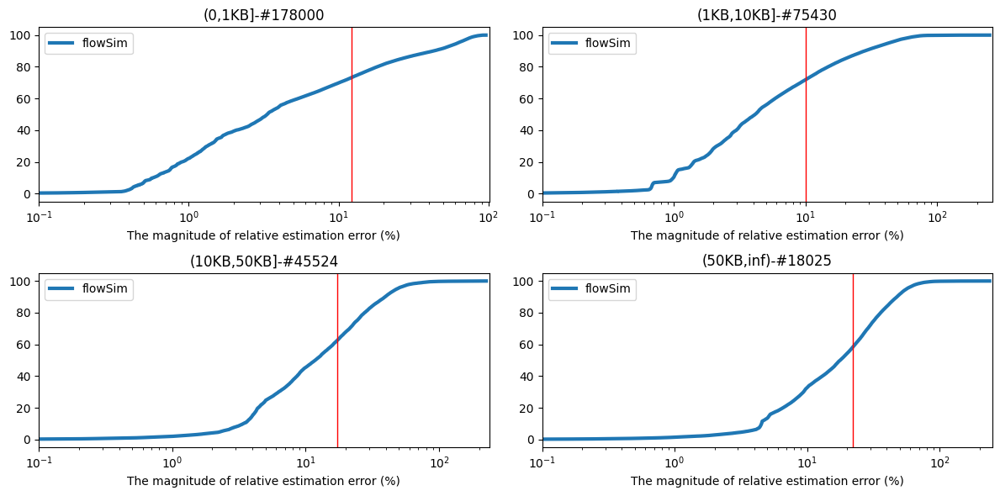

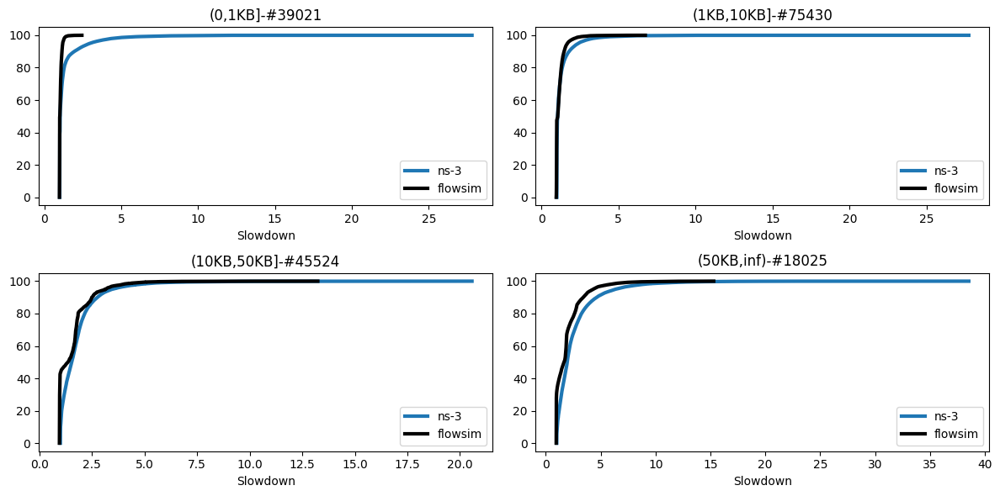

In [13]:
res_ns3_total[res_ns3_total<1]=1
res_flowsim_total[res_flowsim_total<1]=1
gt=abs(res_ns3_total-res_flowsim_total)/res_ns3_total*100
# gt_flowsim=res_flowsim

fig_index=0
plt.figure(fig_index,figsize=(4, 3))  
plt.plot(np.sort(gt), (np.arange(len(gt))/len(gt)*100), linewidth=3, label="flowSim")
# plt.axhline(99, color='green', linewidth=0.5)
# plt.axvline(np.percentile(gt,50), color='red', linewidth=1)
plt.axvline(np.mean(gt), color='red', linewidth=1)
plt.xlim(left=0.1)
plt.xscale('log')
plt.xlabel('The magnitude of relative estimation error (%)')
plt.legend()
# plt.ylim([80, 100])
plt.tight_layout()
fig_index+=1

plt.figure(fig_index,figsize=(12, 6))  
for i in range(len(labels)):
    plt.subplot(2, 2, i + 1)
    plt.title(f"{labels[i]}-#{len(gt)}")
    # plt.xlim([0, 16])
    gt=np.array(res_ns3[i])
    gt_flowsim=np.array(res_flowsim[i])
    
    res=abs(gt-gt_flowsim)/gt*100
    plt.plot(np.sort(res), (np.arange(len(res))/len(res)*100), linewidth=3, label="flowSim")
    # plt.plot(np.sort(gt), (np.arange(len(gt))/len(gt)*100), linewidth=3, label="ns-3")
    # plt.plot(np.sort(gt_flowsim), (np.arange(len(gt_flowsim))/len(gt_flowsim)*100), label="flowsim", linewidth=3,color='black')
        
    # plt.axvline(np.percentile(res,50), color='red', linewidth=1)
    plt.axvline(np.mean(res), color='red', linewidth=1)
    plt.xlim(left=0.1)
    plt.xscale('log')
    plt.xlabel('The magnitude of relative estimation error (%)')
    plt.legend()
    # plt.ylim([80, 100])
plt.tight_layout()
fig_index+=1

plt.figure(fig_index,figsize=(12, 6))  
for i in range(len(labels)):
    plt.subplot(2, 2, i + 1)
    plt.title(f"{labels[i]}-#{len(gt)}")
    # plt.xlim([0, 16])
    gt=np.array(res_ns3[i])
    gt_flowsim=np.array(res_flowsim[i])
    
    plt.plot(np.sort(gt), (np.arange(len(gt))/len(gt)*100), linewidth=3, label="ns-3")
    plt.plot(np.sort(gt_flowsim), (np.arange(len(gt_flowsim))/len(gt_flowsim)*100), label="flowsim", linewidth=3,color='black')
        
    # plt.xscale('log')
    plt.xlabel('Slowdown')
    plt.legend()
    # plt.ylim([80, 100])
plt.tight_layout()
fig_index+=1

In [16]:

dir_input="/data1/lichenni/projects/per-flow-sim/parsimon-eval/expts/fig_8/data_test_config"
topo_type="_topology_flows"

data_list=[]
for shard in np.arange(13):
    topo_type_cur=topo_type
    spec=f"{shard}/ns3"
    try:
        fid = np.load(f"{dir_input}/{spec}/fid{topo_type_cur}.npy")
        if len(fid)==len(set(fid)) and np.all(fid[:-1] <= fid[1:]):
            data_list.append((spec,topo_type_cur))
    except:
        continue
print(len(data_list))
BDP=10*MTU

res_ns3=[[] for _ in range(4)]

for spec_idx,(spec,topo_type) in enumerate(data_list):
    dir_input_tmp = f"{dir_input}/{spec}"
    fid=np.load(f"{dir_input_tmp}/fid{topo_type}.npy")
    sizes = np.load(f"{dir_input_tmp}/fsize.npy")
    fats = np.load(f"{dir_input_tmp}/fat.npy")
    fcts = np.load(f'{dir_input_tmp}/fct{topo_type}.npy')
    i_fcts = np.load(f'{dir_input_tmp}/fct_i{topo_type}.npy')
    sldns = np.divide(fcts, i_fcts)
    
    link_info = np.load(
        f"{dir_input_tmp}/flow_to_path.npy",
        allow_pickle=True,
    )
    n_links_passed = np.array([len(link_info[i]) for i in fid])
    base_delay=get_base_delay_path(sizes,n_links_passed,lr)
    i_fcts_flowsim = get_base_delay_transmission(sizes,lr) + base_delay
    fcts_flowsim=np.load(f'{dir_input_tmp}/flowsim_fct.npy')+base_delay
    sldns_flowsim = np.divide(fcts_flowsim, i_fcts_flowsim)
        
    bins_size=np.digitize(sizes, [MTU, BDP, 5 * BDP])
    for i in range(len(labels)):
        gt = np.extract(bins_size==i, sldns)
        # if spec_idx==0:
        #     gt_flowsim = np.extract(bins_size==i, sldns_flowsim)
        #     res_ns3[i].append(gt_flowsim)
        res_ns3[i].append(gt)

13


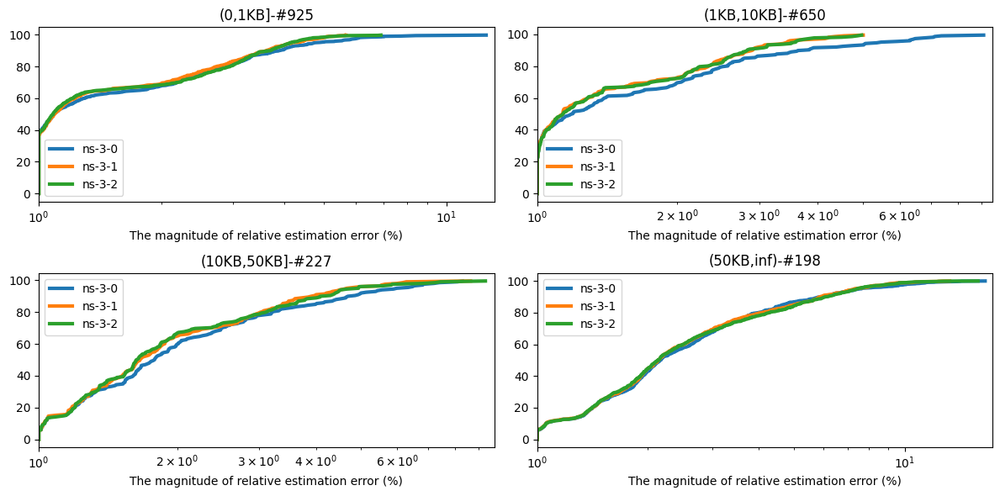

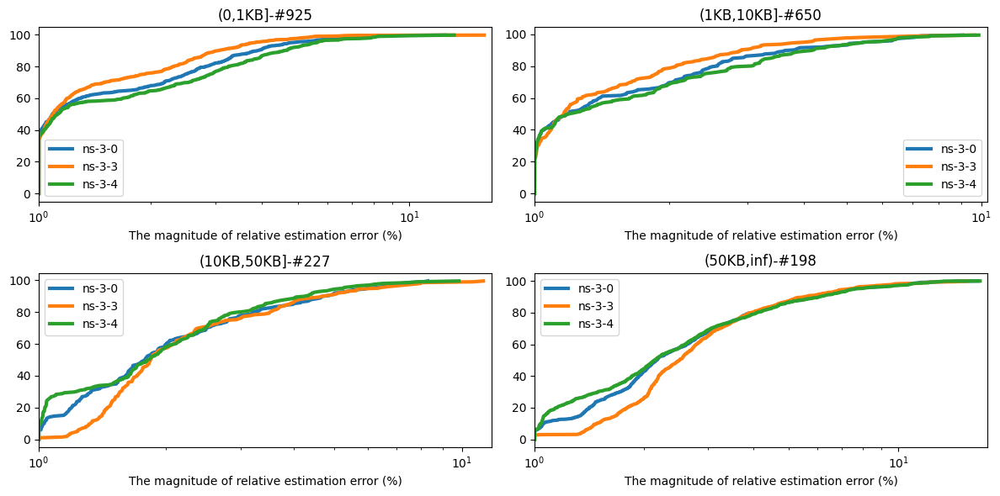

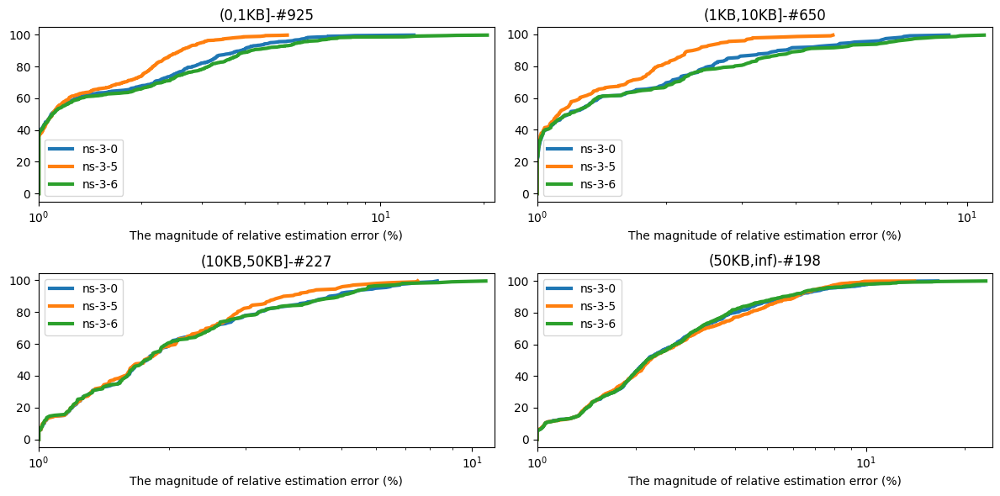

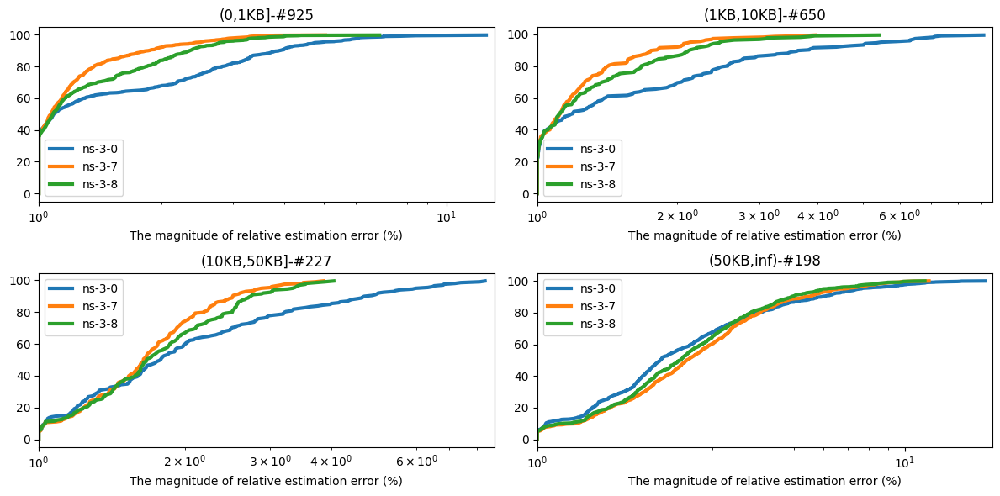

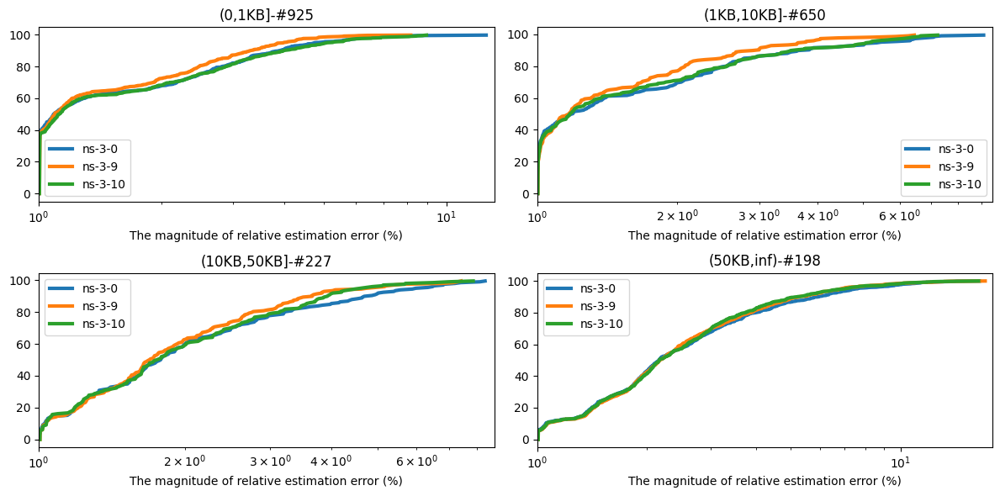

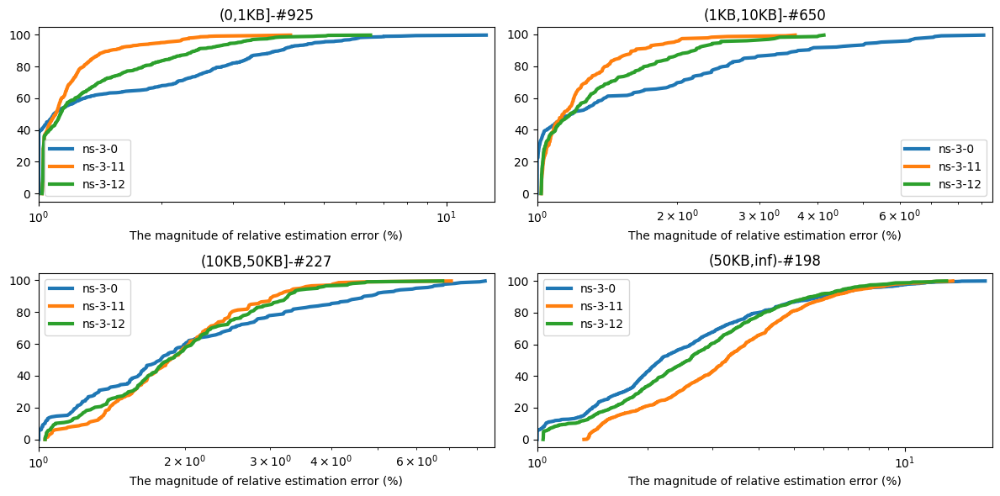

In [17]:
fig_index=0

for k in range(6):
    plt.figure(fig_index,figsize=(12, 6))  
    for i in range(len(labels)):
        plt.subplot(2, 2, i + 1)
        plt.title(f"{labels[i]}-#{len(gt)}")
        for j in [0,2*k+1,2*k+2]:
            gt=np.array(res_ns3[i][j])
            plt.plot(
                np.sort(gt),
                (np.arange(len(gt)) / len(gt) * 100),
                linewidth=3,
                label=f"ns-3-{j}"
            )
        plt.xlim(left=1)
        plt.xscale('log')
        plt.xlabel('The magnitude of relative estimation error (%)')
        plt.legend()
        # plt.ylim([80, 100])
    plt.tight_layout()
    fig_index+=1